# KVALITET PODATAKA - DATA QUALITY

#### Ovaj Jupyter notebook je deo seminarskog rada iz predmeta Predobrada i preprocesiranje podataka za mašinsko učenje kao praktični deo seminarskog rada

#### U njemu će biti predstavljeni praktični primeri na temu kvaliteta podataka što podrazumeva:

    - mere kvaliteta podataka
    - raspodelu podataka
    - korelaciju
    - varijansu 


In [55]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns

In [56]:
data_project1 = pd.read_csv("data/ML_Project1 - Metro_Interstate_Traffic_Volume.csv")

In [57]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,None,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,None,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,None,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,None,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


## Korišćenjem pandas, seaborn i matplotlib metoda

In [58]:
data_project1.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000
mean,281.205870,0.334264,0.000222,49.362231,3259.818355
std,13.338232,44.789133,0.008168,39.015750,1986.860670
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,272.160000,0.000000,0.000000,1.000000,1193.000000
50%,282.450000,0.000000,0.000000,64.000000,3380.000000
75%,291.806000,0.000000,0.000000,90.000000,4933.000000
max,310.070000,9831.300000,0.510000,100.000000,7280.000000


### Mere centralne tendencije

In [59]:
data_project1.mean(numeric_only=True)

temp               281.205870
rain_1h              0.334264
snow_1h              0.000222
clouds_all          49.362231
traffic_volume    3259.818355
dtype: float64

In [60]:
data_project1.median(numeric_only=True)

temp               282.45
rain_1h              0.00
snow_1h              0.00
clouds_all          64.00
traffic_volume    3380.00
dtype: float64

In [61]:
data_project1.mode(axis=0).head(1)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,274.15,0.0,0.0,90.0,Clouds,sky is clear,2013-04-18 22:00:00,353


## Raspodela podataka

#### Traffic_volume atribut

<AxesSubplot:ylabel='Frequency'>

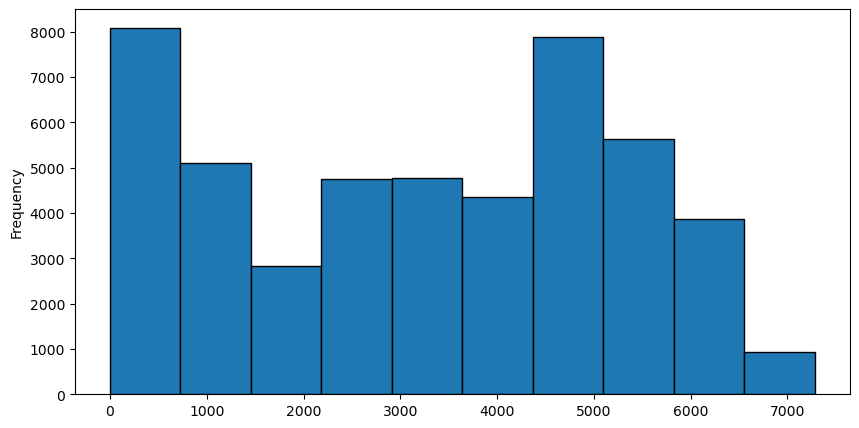

In [183]:
data_project1['traffic_volume'].plot(kind='hist', edgecolor='black', figsize=(10,5))


<AxesSubplot:xlabel='traffic_volume', ylabel='Count'>

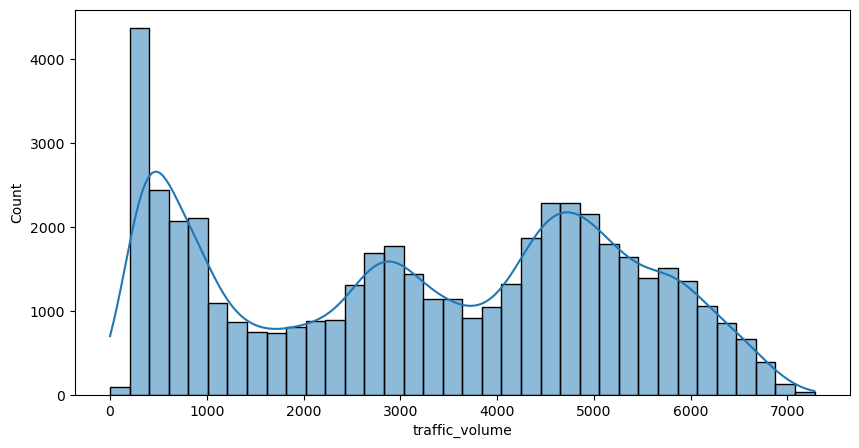

In [63]:
plt.figure(figsize=(10,5))
sns.histplot(data_project1['traffic_volume'], kde=True)

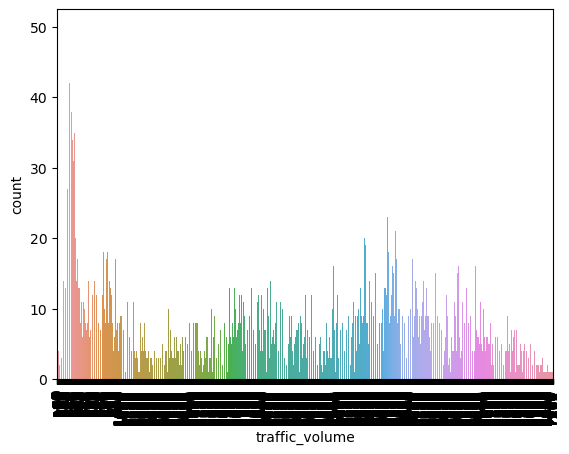

In [64]:
sns.countplot(x = "traffic_volume", data = data_project1)
#plt.figure(figsize=(10,5))
plt.xticks(rotation='vertical')

plt.show()

<AxesSubplot:ylabel='Density'>

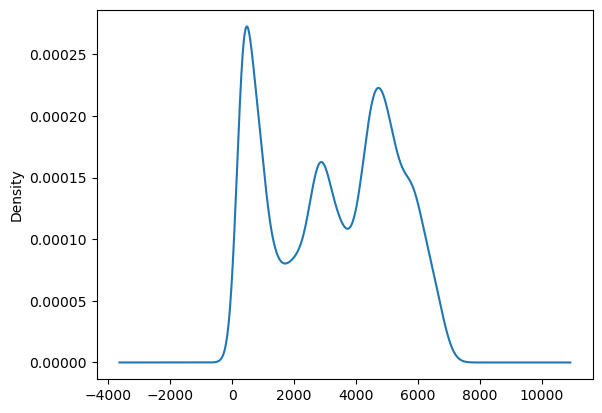

In [65]:
data_project1['traffic_volume'].plot(kind='density')#.set_xlim(-1000,8000)


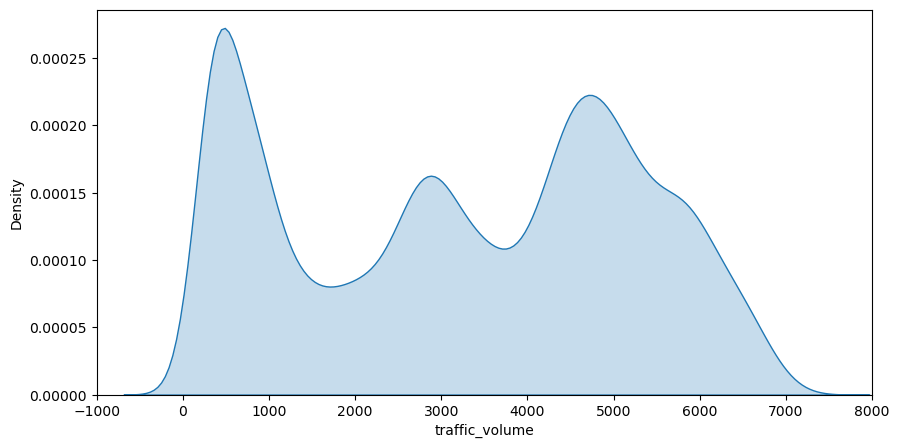

In [66]:
plt.figure(figsize=(10,5))
plt.xlim(-1000,8000)
plt.xlabel('traffic_volume')
plt.ylabel('Density')
sns.kdeplot(data_project1['traffic_volume'],shade=True)
plt.show()

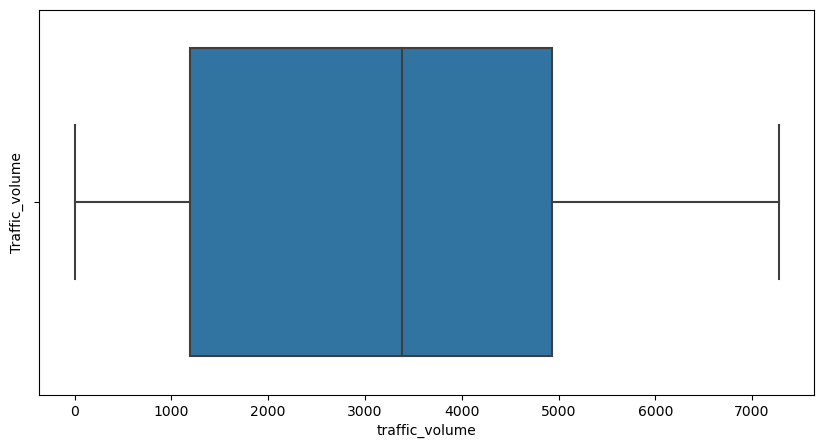

In [67]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Traffic_volume')
sns.boxplot(x=data_project1['traffic_volume'])
plt.show()

#### PDF i CDF dijagrami

<AxesSubplot:xlabel='traffic_volume'>

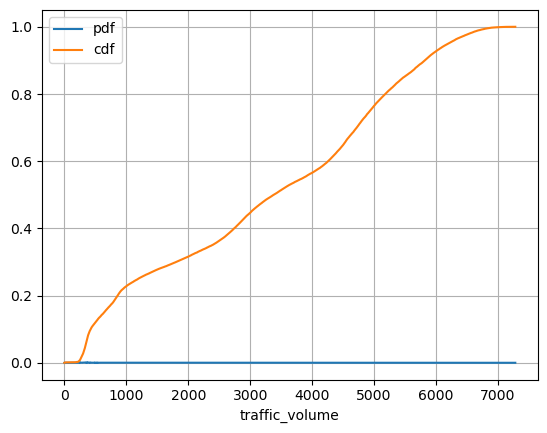

In [68]:
stats_df = data_project1 \
.groupby('traffic_volume') \
['traffic_volume'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'traffic_volume': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "traffic_volume",  y = ['pdf', 'cdf'], grid = True)


#### Temp atribut

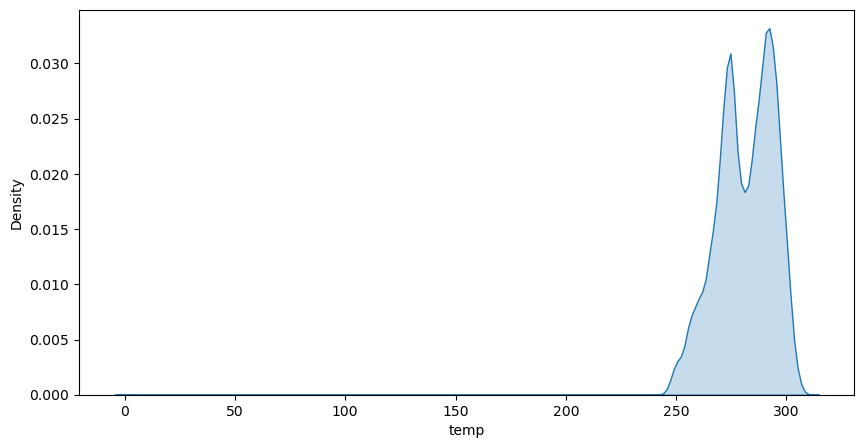

In [198]:
#data_project1['temp'].plot(kind='density')

plt.figure(figsize=(10,5))
# plt.xlim(-1000,8000)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

### PROVERA OUTLIER-A

In [189]:
outlier_data = data_project1.loc[data_project1['temp']<240]
outlier_data.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,10.0,10.0,10.0,10.0,10.000000
mean,0.0,0.0,0.0,0.0,1318.200000
std,0.0,0.0,0.0,0.0,1526.341727
min,0.0,0.0,0.0,0.0,284.000000
25%,0.0,0.0,0.0,0.0,379.250000
50%,0.0,0.0,0.0,0.0,736.500000
75%,0.0,0.0,0.0,0.0,1493.000000
max,0.0,0.0,0.0,0.0,5150.000000


In [190]:
outlier_data.head(10)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
11898,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 03:00:00,361
11899,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 04:00:00,734
11900,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 05:00:00,2557
11901,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-01-31 06:00:00,5150
11946,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 03:00:00,291
11947,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 04:00:00,284
11948,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 05:00:00,434
11949,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 06:00:00,739
11950,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 07:00:00,962
11951,None,0.0,0.0,0.0,0,Clear,sky is clear,2014-02-02 08:00:00,1670


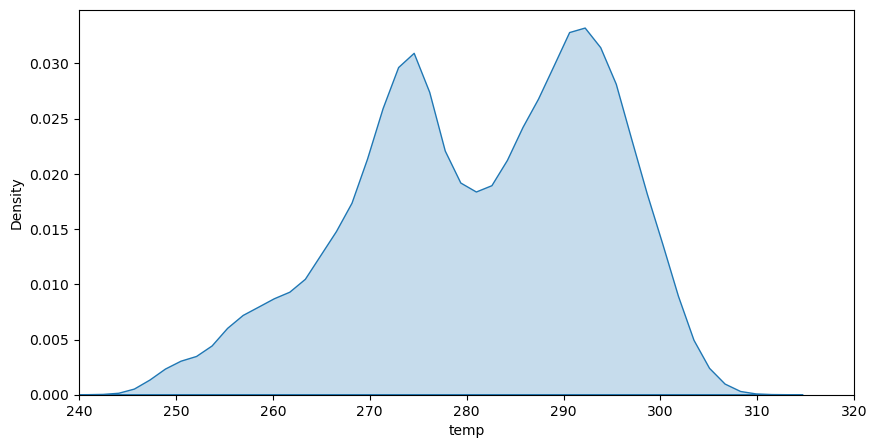

In [199]:
plt.figure(figsize=(10,5))
plt.xlim(240,320)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

#### PDF i CDF grafici

<AxesSubplot:xlabel='temp'>

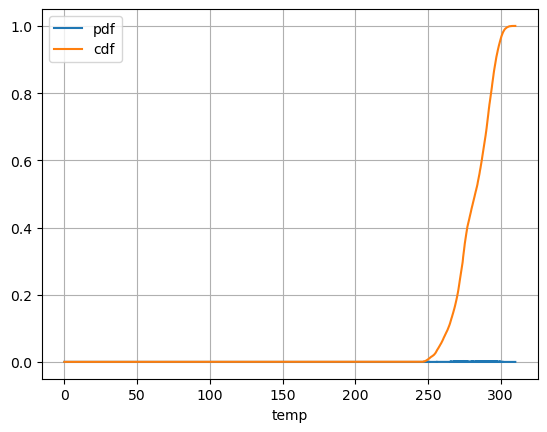

In [69]:
stats_df = data_project1 \
.groupby('temp') \
['temp'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'temp': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "temp",  y = ['pdf', 'cdf'], grid = True) #, xlim=(200,320))

<AxesSubplot:ylabel='Density'>

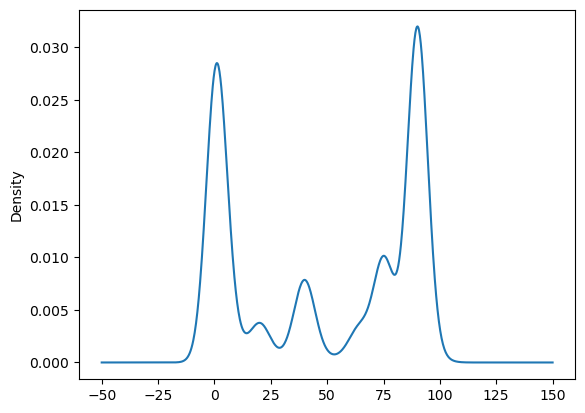

In [74]:
data_project1['clouds_all'].plot(kind='density')


#### Kategorički atributi

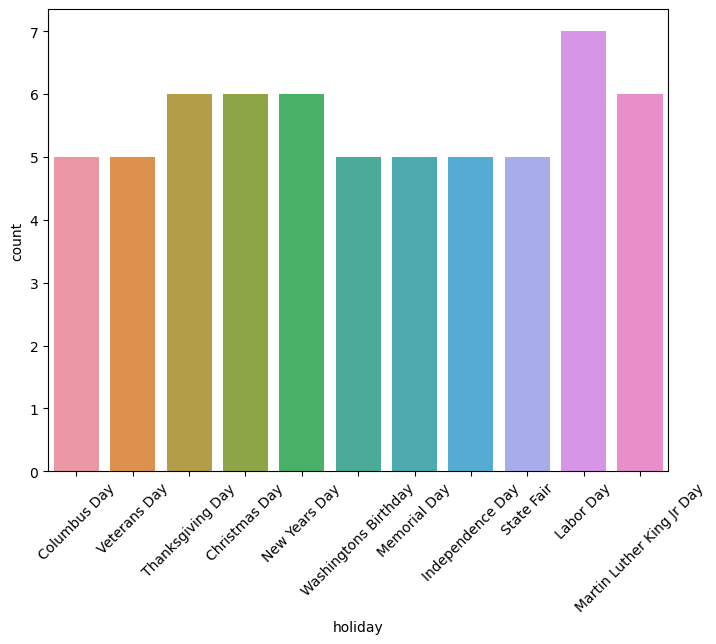

In [75]:
holidays = data_project1.loc[data_project1['holiday'] != 'None']
plt.figure(figsize=(8,6))
sns.countplot(x='holiday', data= holidays)
plt.xticks(rotation=45)
plt.show()

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

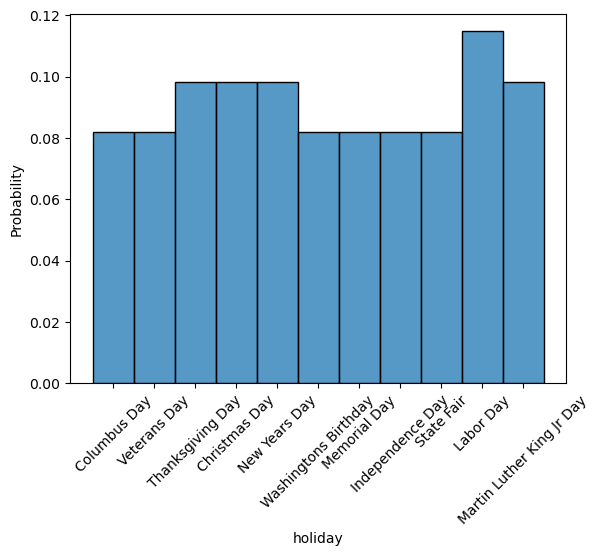

In [76]:
holiday_data = data_project1.loc[data_project1['holiday'] != 'None']['holiday']
sns.histplot(holiday_data, stat='probability')
plt.xticks(rotation=45)

<AxesSubplot:xlabel='count', ylabel='weather_main'>

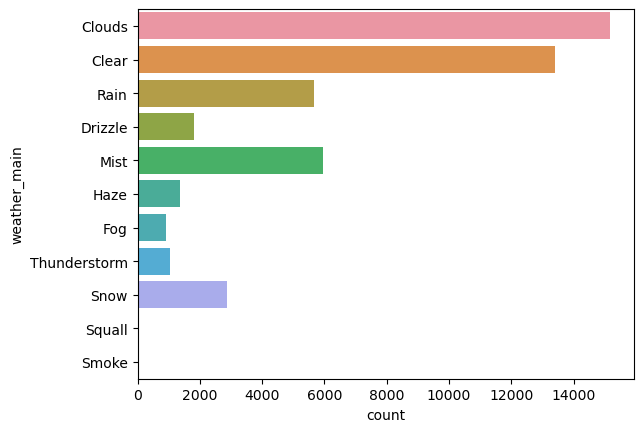

In [77]:
sns.countplot(y='weather_main', data=data_project1)

## Matrica korelacije

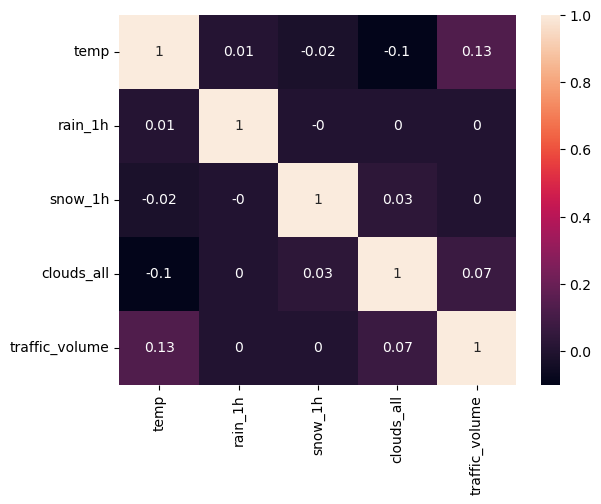

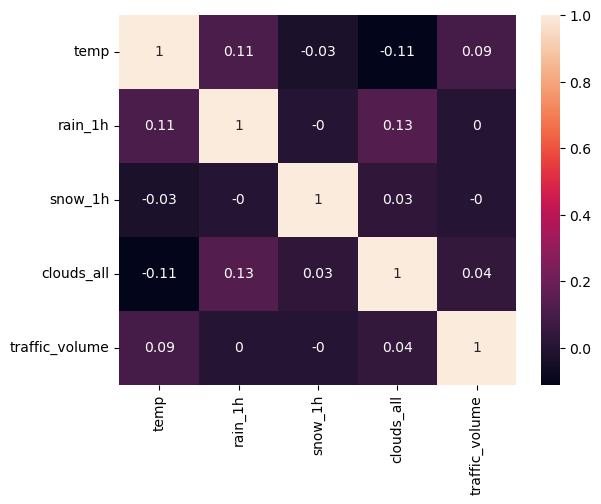

In [78]:
matrix = data_project1.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [79]:
data_project1.var(numeric_only=True).round(2)

temp                  177.91
rain_1h              2006.07
snow_1h                 0.00
clouds_all           1522.23
traffic_volume    3947615.32
dtype: float64

In [80]:
data_project1.std(numeric_only=True).round(2)

temp                13.34
rain_1h             44.79
snow_1h              0.01
clouds_all          39.02
traffic_volume    1986.86
dtype: float64

#### Korišćenjem ProfileReport klase

In [81]:
project1_report = ProfileReport(data_project1)

#### EDA analiza Projekta 1

In [82]:
project1_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### ML PROJECT 2 

In [83]:
data_project2 = pd.read_csv("data/ML_Project2 - responses.csv")

In [84]:
data_project2.head()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,...,20.0,163.0,48.0,1.0,female,right handed,college/bachelor degree,no,village,block of flats
1,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,...,19.0,163.0,58.0,2.0,female,right handed,college/bachelor degree,no,city,block of flats
2,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,...,20.0,176.0,67.0,2.0,female,right handed,secondary school,no,city,block of flats
3,5.0,3.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,...,22.0,172.0,59.0,1.0,female,right handed,college/bachelor degree,yes,city,house/bungalow
4,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,...,20.0,170.0,59.0,1.0,female,right handed,secondary school,no,village,house/bungalow


In [85]:
data_project2._get_numeric_data().columns

Index(['Music', 'Slow songs or fast songs', 'Dance', 'Folk', 'Country',
       'Classical music', 'Musical', 'Pop', 'Rock', 'Metal or Hardrock',
       ...
       'Shopping centres', 'Branded clothing', 'Entertainment spending',
       'Spending on looks', 'Spending on gadgets',
       'Spending on healthy eating', 'Age', 'Height', 'Weight',
       'Number of siblings'],
      dtype='object', length=139)

In [86]:
data_project2_object = data_project2.select_dtypes(include='object')
#print(data_project2_object.columns)

print("Broj unique vrednosti svakog kategoričkog atributa")
print(data_project2[data_project2_object.columns].nunique())

Broj unique vrednosti svakog kategoričkog atributa
Smoking                   4
Alcohol                   3
Punctuality               3
Lying                     4
Internet usage            4
Gender                    2
Left - right handed       2
Education                 6
Only child                2
Village - town            2
House - block of flats    2
dtype: int64


## Korišćenjem pandas, seaborn i matplotlib metoda

In [87]:
data_project2.describe()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Shopping centres,Branded clothing,Entertainment spending,Spending on looks,Spending on gadgets,Spending on healthy eating,Age,Height,Weight,Number of siblings
count,1007.000000,1008.000000,1006.000000,1005.000000,1005.000000,1003.000000,1008.000000,1007.000000,1004.000000,1007.000000,...,1008.000000,1008.000000,1007.000000,1007.000000,1010.000000,1008.00000,1003.000000,990.000000,990.000000,1004.000000
mean,4.731877,3.328373,3.113320,2.288557,2.123383,2.956132,2.761905,3.471698,3.761952,2.361470,...,3.234127,3.050595,3.201589,3.106256,2.870297,3.55754,20.433699,173.514141,66.405051,1.297809
std,0.664049,0.833931,1.170568,1.138916,1.076136,1.252570,1.260845,1.161400,1.184861,1.372995,...,1.323062,1.306321,1.188947,1.205368,1.284970,1.09375,2.828840,10.024505,13.839561,1.013348
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,15.000000,62.000000,41.000000,0.000000
25%,5.000000,3.000000,2.000000,1.000000,1.000000,2.000000,2.000000,3.000000,3.000000,1.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,3.00000,19.000000,167.000000,55.000000,1.000000
50%,5.000000,3.000000,3.000000,2.000000,2.000000,3.000000,3.000000,4.000000,4.000000,2.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,4.00000,20.000000,173.000000,64.000000,1.000000
75%,5.000000,4.000000,4.000000,3.000000,3.000000,4.000000,4.000000,4.000000,5.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.00000,22.000000,180.000000,75.000000,2.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,30.000000,203.000000,165.000000,10.000000


### Mere centralne tendencije

In [88]:
data_project2.mean(numeric_only=True)

Music                           4.731877
Slow songs or fast songs        3.328373
Dance                           3.113320
Folk                            2.288557
Country                         2.123383
                                 ...    
Spending on healthy eating      3.557540
Age                            20.433699
Height                        173.514141
Weight                         66.405051
Number of siblings              1.297809
Length: 139, dtype: float64

In [89]:
data_project2.median(numeric_only=True)

Music                           5.0
Slow songs or fast songs        3.0
Dance                           3.0
Folk                            2.0
Country                         2.0
                              ...  
Spending on healthy eating      4.0
Age                            20.0
Height                        173.0
Weight                         64.0
Number of siblings              1.0
Length: 139, dtype: float64

In [90]:
data_project2.mode(axis=0).head(1)

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,3.0,2.0,2.0,3.0,3.0,4.0,5.0,1.0,...,19.0,170.0,60.0,1.0,female,right handed,secondary school,no,city,block of flats


## Raspodela podataka

#### Age atribut

<AxesSubplot:xlabel='Age', ylabel='Count'>

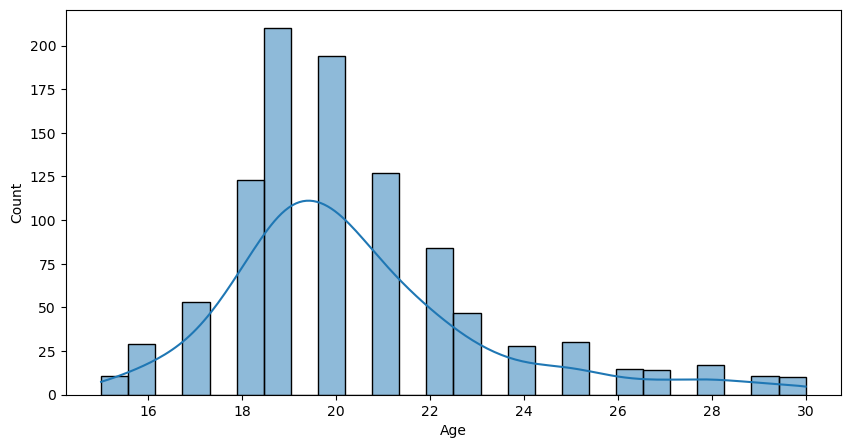

In [91]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Age'], kde=True)

<AxesSubplot:xlabel='Age'>

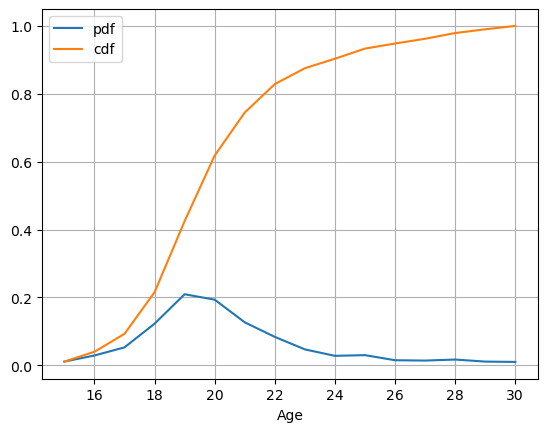

In [92]:
stats_df = data_project2 \
.groupby('Age') \
['Age'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Age': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Age",  y = ['pdf', 'cdf'], grid = True)

#### Height atribut

<AxesSubplot:xlabel='Height', ylabel='Count'>

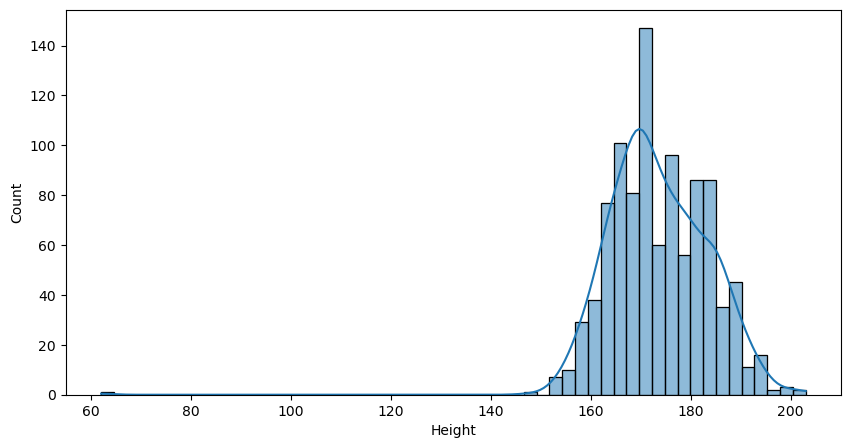

In [93]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Height'], kde=True)

<AxesSubplot:xlabel='Height'>

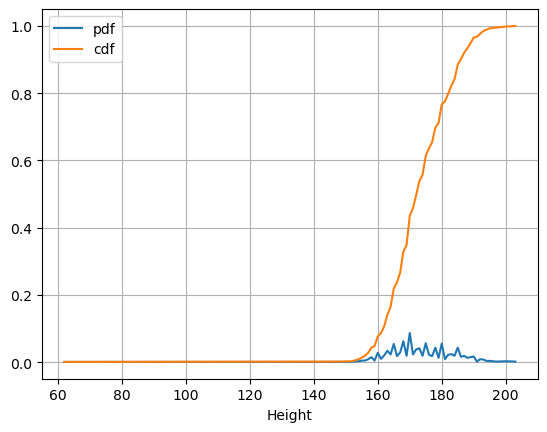

In [94]:
stats_df = data_project2 \
.groupby('Height') \
['Height'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Height': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Height",  y = ['pdf', 'cdf'], grid = True)

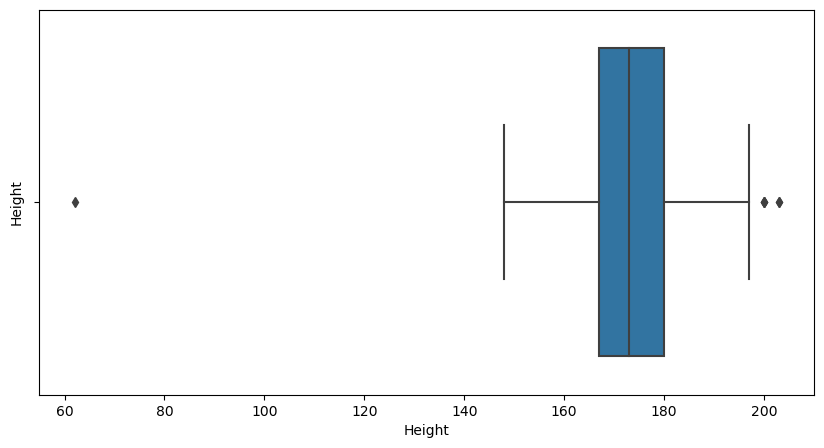

In [95]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Height')
sns.boxplot(x=data_project2['Height'])
plt.show()

#### Weight atribut

<AxesSubplot:xlabel='Weight', ylabel='Count'>

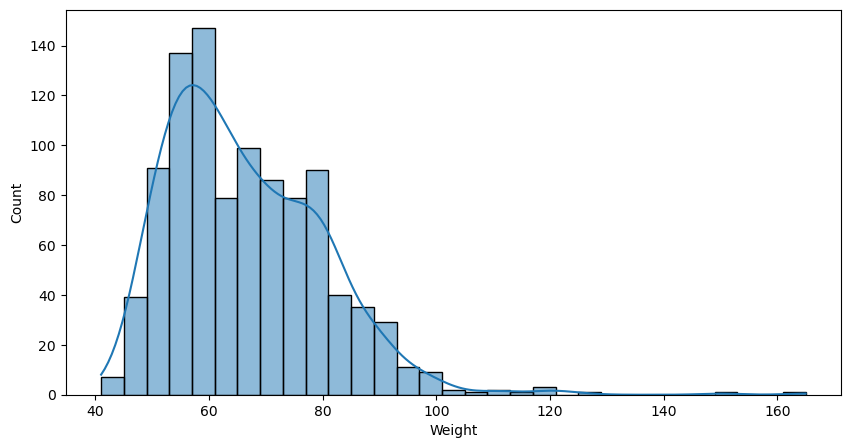

In [96]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Weight'], kde=True)

<AxesSubplot:xlabel='Weight'>

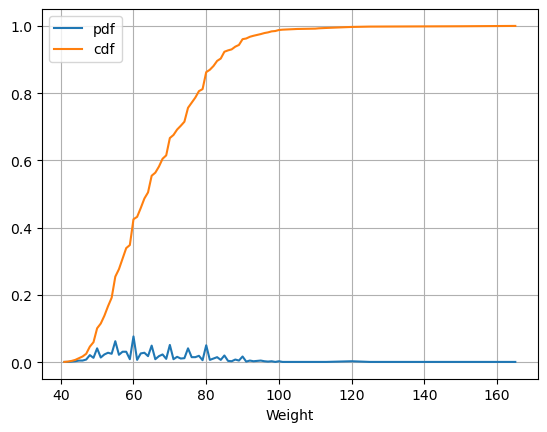

In [97]:
stats_df = data_project2 \
.groupby('Weight') \
['Weight'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Weight': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Weight",  y = ['pdf', 'cdf'], grid = True)

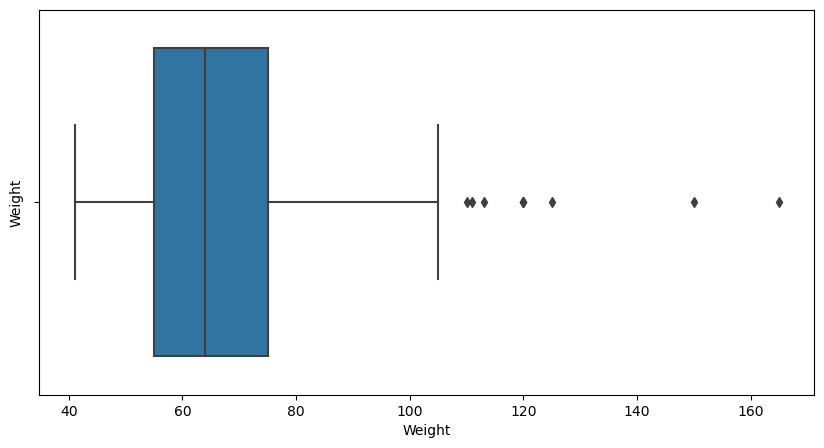

In [98]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Weight')
sns.boxplot(x=data_project2['Weight'])
plt.show()

#### Kategorički podaci

<AxesSubplot:xlabel='Gender', ylabel='count'>

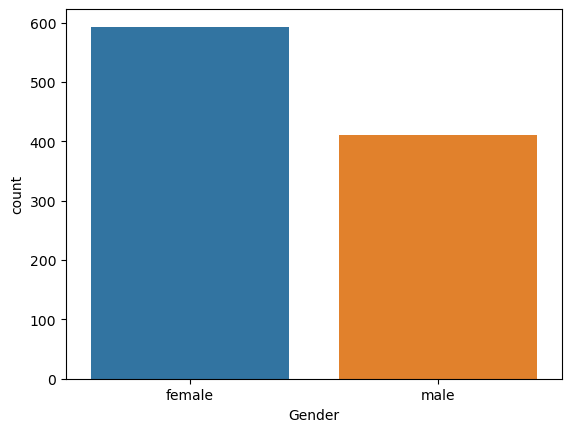

In [99]:
sns.countplot(x='Gender', data=data_project2)

<AxesSubplot:xlabel='Smoking', ylabel='count'>

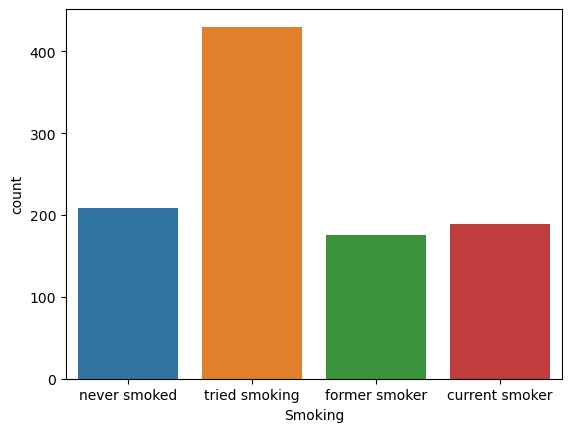

In [100]:
sns.countplot(x='Smoking', data=data_project2)

<AxesSubplot:xlabel='count', ylabel='Education'>

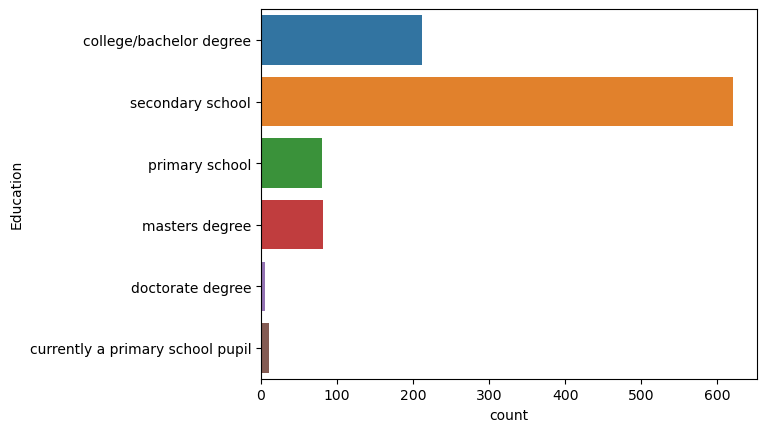

In [101]:
sns.countplot(y='Education', data=data_project2)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

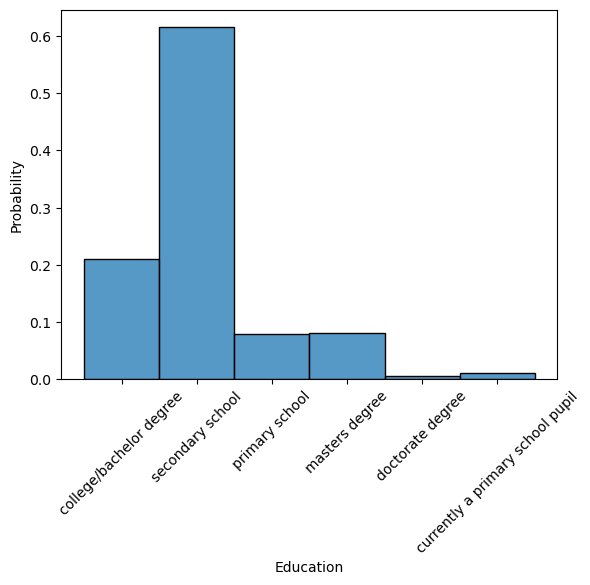

In [102]:
sns.histplot(data_project2['Education'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

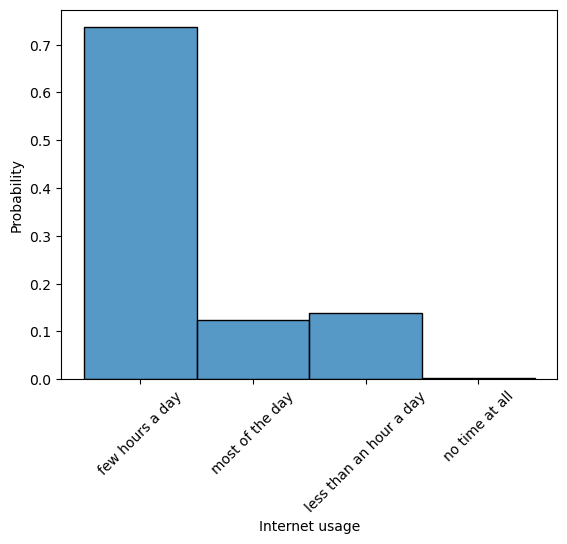

In [103]:
sns.histplot(data_project2['Internet usage'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2], [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

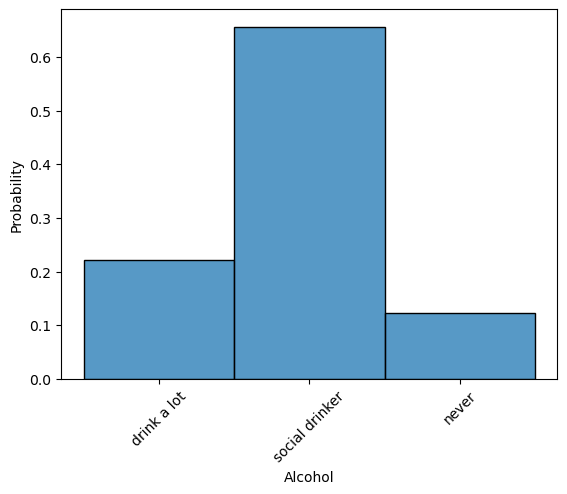

In [104]:
sns.histplot(data_project2['Alcohol'], stat='probability')
plt.xticks(rotation=45)

## Matrica korelacije

C:\Users\Legion\AppData\Local\Temp\ipykernel_10344\728409174.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)


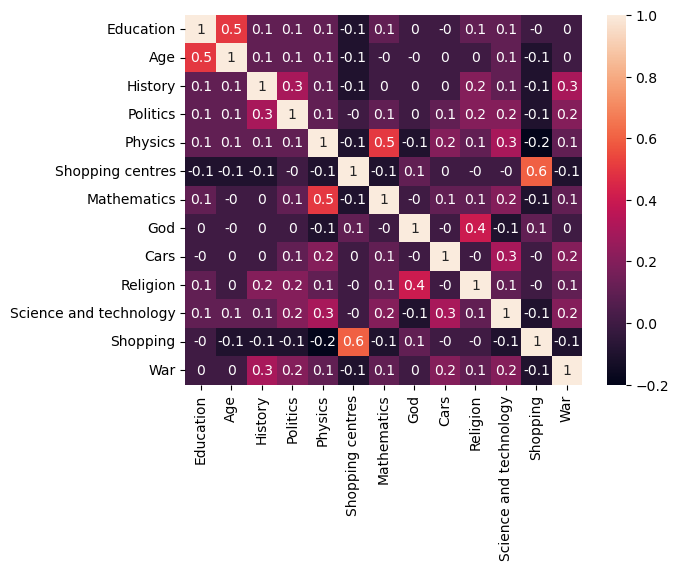

In [105]:

PersonalityDF = data_project2[['Gender', 'Education', 'Age', 'History', 'Politics', 'Physics', 'Shopping centres', 'Mathematics', 'God', 'Cars', 'Religion', 'Science and technology', 'Shopping', 'War']]
PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)

matrix = PersonalityDF._get_numeric_data().corr(method='kendall', min_periods=1).round(1)
#matrix = PersonalityDF.apply(lambda x : pd.factorize(x)[0]).corr(method='kendall', min_periods=1).round(1)

sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [113]:
data_project2.var(numeric_only=True).round(2).sort_values()

Personality           0.41
Music                 0.44
Dreams                0.47
Movies                0.48
Fun with friends      0.54
                     ...  
Pets                  2.39
Elections             2.48
Age                   8.00
Height              100.49
Weight              191.53
Length: 139, dtype: float64

In [112]:
data_project2.std(numeric_only=True).round(2).sort_values()

Personality          0.64
Music                0.66
Dreams               0.68
Movies               0.69
Fun with friends     0.74
                    ...  
Pets                 1.55
Elections            1.57
Age                  2.83
Height              10.02
Weight              13.84
Length: 139, dtype: float64

#### EDA analiza Projekta 2

In [107]:
project2_report = ProfileReport(data_project2)

In [108]:
project2_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### ML PROJECT 3

In [114]:
data_project3 = pd.read_csv("data/ML_Project3 - Churn_Modelling.csv")

In [167]:
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


## Korišćenjem pandas, seaborn i matplotlib metoda

In [165]:
data_project3.describe()

,RowNumber,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,10000.00000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,5000.50000,1.569094e+07,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,2886.89568,7.193619e+04,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,1.00000,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,2500.75000,1.562853e+07,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,5000.50000,1.569074e+07,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,7500.25000,1.575323e+07,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,10000.00000,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


### Mere centralne tendencije

In [172]:
data_project3.mean(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690940.57
CreditScore             650.53
Age                      38.92
Tenure                    5.01
Balance               76485.89
NumOfProducts             1.53
HasCrCard                 0.71
IsActiveMember            0.52
EstimatedSalary      100090.24
Exited                    0.20
dtype: float64

In [171]:
data_project3.median(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690738.00
CreditScore             652.00
Age                      37.00
Tenure                    5.00
Balance               97198.54
NumOfProducts             1.00
HasCrCard                 1.00
IsActiveMember            1.00
EstimatedSalary      100193.92
Exited                    0.00
dtype: float64

In [168]:
data_project3.mode(axis=0).head(1)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15565701,Smith,850.0,France,Male,37.0,2.0,0.0,1.0,1.0,1.0,24924.92,0.0


## Raspodela podataka

#### CreditScore atribut

<AxesSubplot:xlabel='CreditScore', ylabel='Count'>

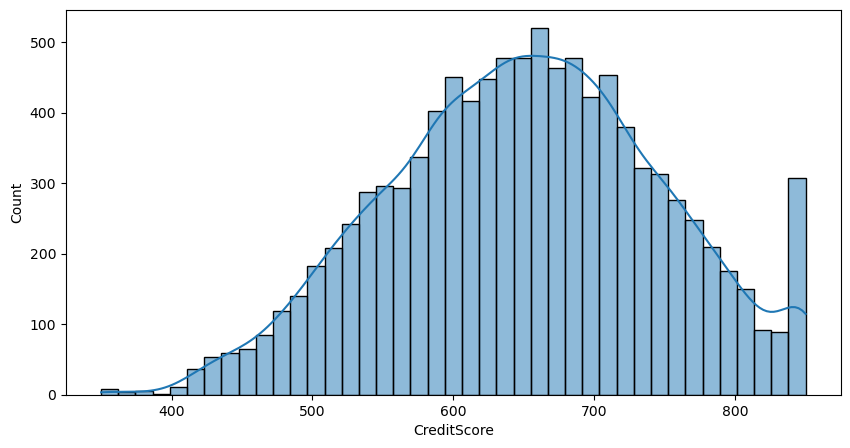

In [121]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['CreditScore'], kde=True)

<AxesSubplot:xlabel='CreditScore', ylabel='Density'>

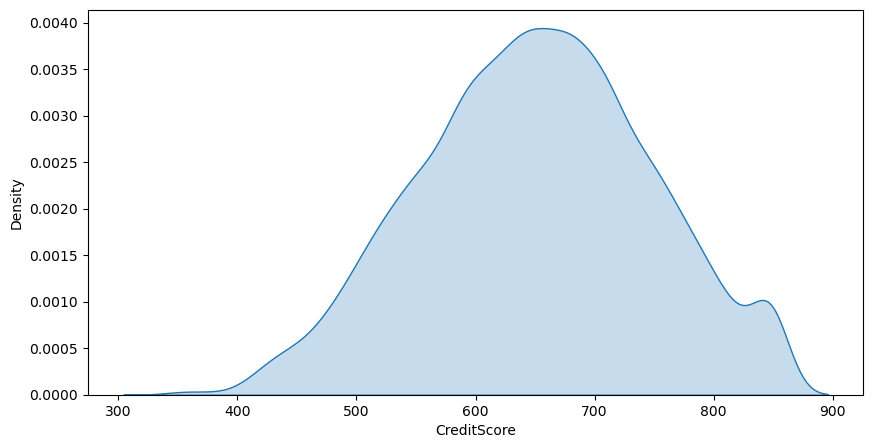

In [124]:
plt.figure(figsize=(10,5))
plt.xlabel('CreditScore')
plt.ylabel('Density')
sns.kdeplot(data_project3['CreditScore'],shade=True)

#### Age

<AxesSubplot:xlabel='Age', ylabel='Count'>

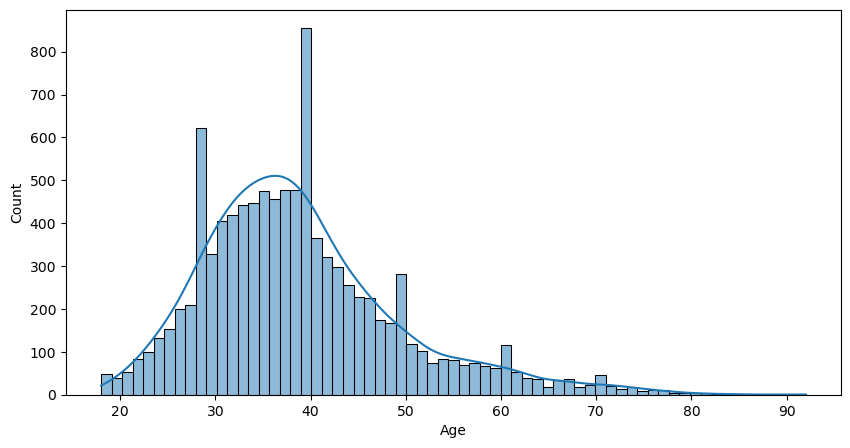

In [125]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Age'], kde=True)

#### Tenure atribut

<AxesSubplot:xlabel='Tenure', ylabel='Count'>

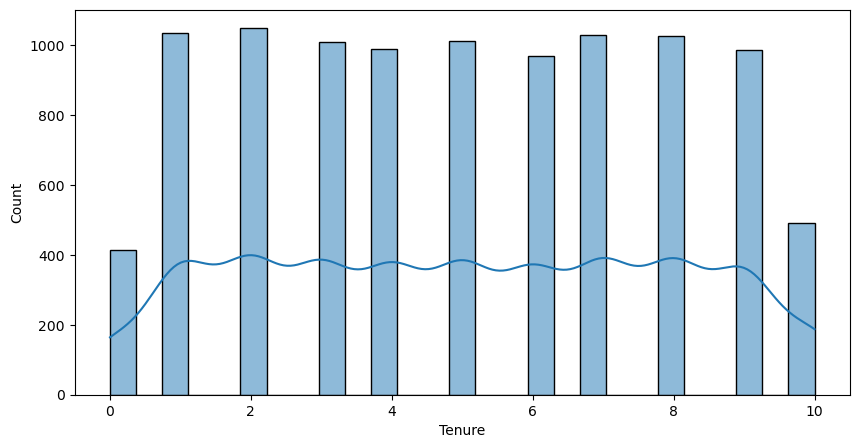

In [160]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Tenure'], kde=True)

#### Balance atribut

<AxesSubplot:xlabel='Balance', ylabel='Count'>

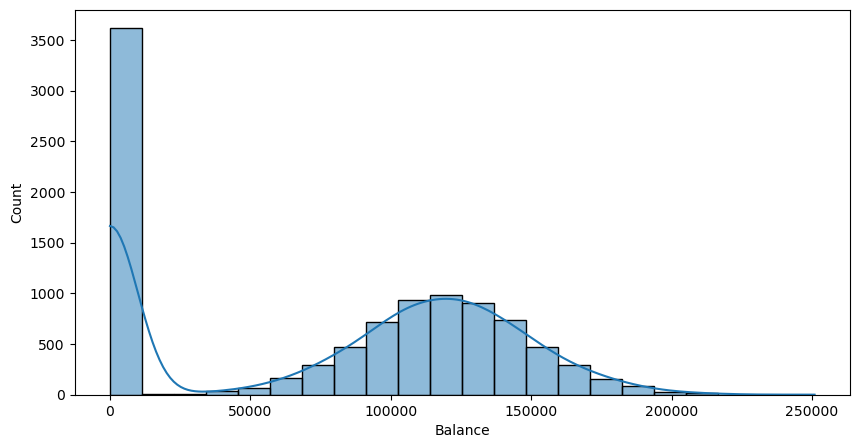

In [161]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Balance'], kde=True)

#### Ukoliko izbacimo male vrednosti dobijamo gotovo idealni Gausovu raspodelu

<AxesSubplot:xlabel='Balance', ylabel='Count'>

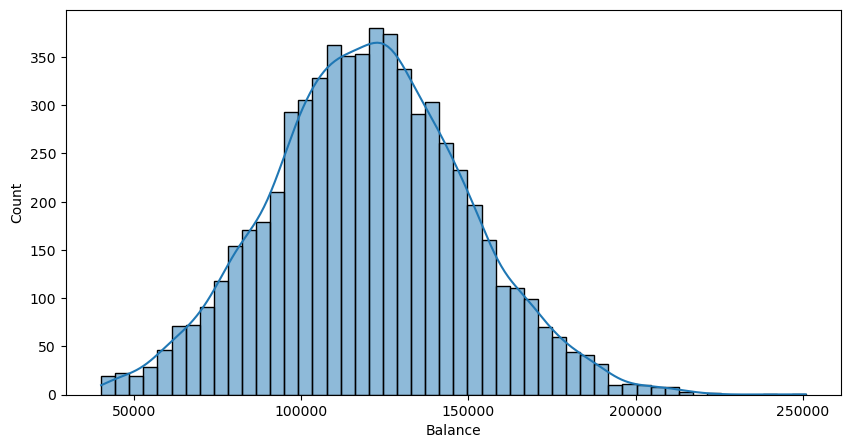

In [164]:
filtered_data_project3 = data_project3.loc[data_project3['Balance']> 40000]['Balance']

plt.figure(figsize=(10,5))
sns.histplot(filtered_data_project3, kde=True)

## Matrica korelacije

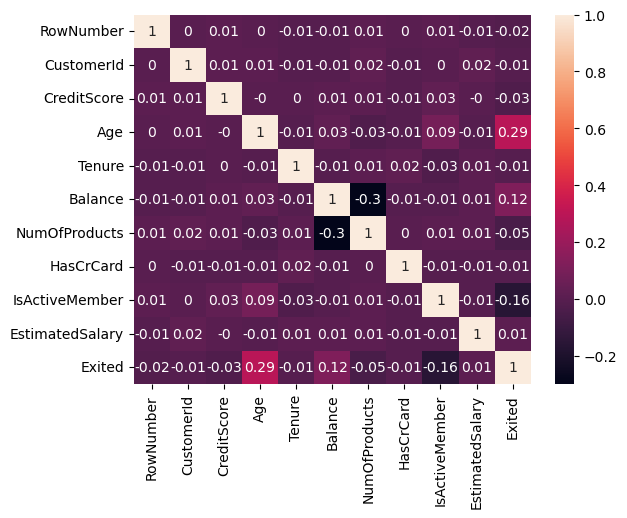

In [175]:
matrix = data_project3.corr().round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [179]:
data_project3.var(numeric_only=True).round(3)

RowNumber          8.334167e+06
CustomerId         5.174815e+09
CreditScore        9.341860e+03
Age                1.099940e+02
Tenure             8.365000e+00
Balance            3.893436e+09
NumOfProducts      3.380000e-01
HasCrCard          2.080000e-01
IsActiveMember     2.500000e-01
EstimatedSalary    3.307457e+09
Exited             1.620000e-01
dtype: float64

In [180]:
data_project3.std(numeric_only=True).round(2)

RowNumber           2886.90
CustomerId         71936.19
CreditScore           96.65
Age                   10.49
Tenure                 2.89
Balance            62397.41
NumOfProducts          0.58
HasCrCard              0.46
IsActiveMember         0.50
EstimatedSalary    57510.49
Exited                 0.40
dtype: float64

#### EDA analiza Projekta 3

In [115]:
project3_report = ProfileReport(data_project3)

In [116]:
project3_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]